# Loading the microCT stack and detection of cones
### Extracting ellipse parameters, cleaning of data, generate height vs. width

Following tasks are performed:
- Load and resize microCT image stacks 
- Find cones in each layer
- Reassign falsely labelled centers
- Clean false detection by clusters and width
- Export height and width data in .csv file

In [ ]:


import numpy as np
import os
from skimage.io import imread
from skimage import transform
import matplotlib.pyplot as plt
import cv2
from PIL import Image
from tifffile import imwrite
from pathlib import Path
font = cv2.FONT_HERSHEY_SIMPLEX
from pathlib import Path
from skimage.filters import threshold_otsu
import shutil
from skimage.measure import regionprops
from scipy.spatial import distance
import pandas as pd

pd.set_option('display.max_rows', None)  # Show all rows
pd.set_option('display.max_columns', None)  # Show all columns
pd.set_option('display.width', None)  # Auto-adjust width
pd.set_option('display.max_colwidth', None)  # Show full column width

In [2]:
#Create Hu moments for circle
# Create a blank 500x500 black image
img = np.zeros((500, 500), dtype=np.uint8)

# Draw a filled white circle on the image
center = (250, 250)  # Center of the image
radius = 100         # Radius of the circle
cv2.circle(img, center, radius, 255, -1)  # -1 fills the circle

# Compute the image moments
moments = cv2.moments(img)

# Compute the Hu Moments (returns a 7x1 array)
huMoments = cv2.HuMoments(moments).flatten()

# Optionally, apply a logarithmic scale transformation for better interpretation
logHuMoments = -np.sign(huMoments) * np.log10(np.abs(huMoments))

logHuMoments = logHuMoments.reshape(-1,1)
logHuMoments[-1] = 0

/tmp/ipykernel_79903/1122209684.py:17: RuntimeWarning: divide by zero encountered in log10
  logHuMoments = -np.sign(huMoments) * np.log10(np.abs(huMoments))
/tmp/ipykernel_79903/1122209684.py:17: RuntimeWarning: invalid value encountered in multiply
  logHuMoments = -np.sign(huMoments) * np.log10(np.abs(huMoments))


In [3]:
files = []
directory =Path("final/full_stack")
print(os.path.isdir(directory))
for file in directory.iterdir():
   if (file.suffix == ".tif"):
      files.append(str(file.stem+file.suffix))
#Do not forget to sort the files :)       
files.sort()

True


In [4]:

idx =0
im_list =[]
max = len(os.listdir("final/full_stack"))-2
number_of_slices = np.linspace(1, max, num=500, dtype=int) #Must be even 
#fig, axs = plt.subplots(int(len(number_of_slices)/2), 2, figsize=(40, 40))
for i in range(1,int(len(number_of_slices)/2)+1):
    for j in range(2):
        #print("i"+str(i))
        #print("idx"+str(idx))
        #print(idx)
        im = imread("final/full_stack/"+str(files[number_of_slices[idx]]))
        h, w = im.shape
        im_resized = transform.resize(im,(h // 2, w // 2), anti_aliasing=True)
        im_resized= (im_resized * 255).astype(np.uint8)
        im_resized= im_resized[h-w+500:-13,:2000]
        im_list.append(im_resized)
        #axs[i-1, j].imshow(im_resized, cmap='gray') 
        #axs[i-1, j].set_title("final/"+str(files[number_of_slices[idx]]))
        #axs[i-1, j].axis('off')
        idx =idx+1;

#plt.tight_layout()
#plt.show()

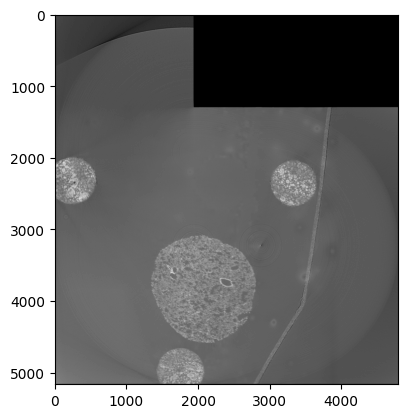

In [5]:
im = imread("final/full_stack/"+str(files[number_of_slices[80]]))
plt.imshow(im, cmap ="gray" )


In [6]:
import numpy as np
import cv2
import pandas as pd
from skimage.measure import regionprops
import matplotlib.pyplot as plt

def segment_ellipses(im_list, number_of_slices):
    """
    Detect ellipses (cones) in a list of images and extract features.
    Hu moments filtering removed; detection is based on thresholding, edges, and morphology.
    
    Parameters
    ----------
    im_list : list of ndarray
        List of grayscale images to process.
    number_of_slices : list of int
        Slice indices corresponding to each image.
    
    Returns
    -------
    df_ellips : pandas.DataFrame
        Contains features for detected ellipses:
        ["cone1", "cone2", "cone3",
         "center1x","center1y",
         "center2x","center2y",
         "center3x","center3y",
         "slice_index"]
    """
    
    df_ellips = pd.DataFrame(columns=[
        "cone1", "cone2", "cone3",
        "center1x","center1y",
        "center2x","center2y",
        "center3x","center3y",
        "slice_index"
    ])
    
    idx_im = 0  # Index of current image
    
    for im in im_list:
        # Temporary row for this image
        df_temp = pd.DataFrame(columns=df_ellips.columns)
        df_temp.loc[0] = [None] * len(df_temp.columns)
        
        im_temp = np.copy(im)  # avoid altering original image
        
        # Adaptive thresholding
        adaptive_thresh = cv2.adaptiveThreshold(
            im_temp, 255, cv2.ADAPTIVE_THRESH_MEAN_C, cv2.THRESH_BINARY, 11, 4
        )
        
        # Smooth and detect edges
        blurred = cv2.GaussianBlur(adaptive_thresh, (15, 15), 2)
        edges = cv2.Canny(blurred, 250, 255)
        
        # Morphological filtering
        kernel_open = cv2.getStructuringElement(cv2.MORPH_CROSS, (1, 1))
        opened = cv2.morphologyEx(edges, cv2.MORPH_OPEN, kernel_open)
        kernel_close = np.ones((12, 12), np.uint8)
        closed = cv2.morphologyEx(opened, cv2.MORPH_CLOSE, kernel_close)
        
        # Keep connected components with proper size
        num_labels, labels, stats, centroids = cv2.connectedComponentsWithStats(closed)
        output_image = np.zeros_like(closed)
        min_area = 3000
        
        for i in range(1, num_labels):  # skip background
            area = stats[i, cv2.CC_STAT_AREA]
            if min_area <= area < 90000:
                temp_img = np.zeros_like(closed)
                temp_img[labels == i] = 255
                region = regionprops(temp_img)[0]
                if region.eccentricity > 0.1:
                    output_image[labels == i] = 255
        
        # Detect contours
        contours, _ = cv2.findContours(output_image, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
        
        idx_cones = 0
        idx_centers = 0
        dis_im = np.copy(output_image)
        
        for cnt in contours:
            if len(cnt) < 5:
                continue
            
            ((centx, centy), (width, height), angle) = cv2.fitEllipseDirect(cnt)
            
            # Apply size and ratio filters
            if (width < 600 and width*height > 15000 and width > 120 
                and (width/height) > 0.7 and idx_cones < 3):
                
                true_width = min(width, height)
                x1, y1 = int(centx - true_width / 2), int(centy)
                x2, y2 = int(centx + true_width / 2), int(centy)
                
                # Draw ellipse and center line for visualization
                dis_im = cv2.ellipse(dis_im, (int(centx), int(centy)), 
                                     (int(width/2), int(height/2)), angle, 0, 360, (255, 0, 255), 10)
                dis_im = cv2.putText(dis_im, str(idx_cones+1), (int(centx)+200, int(centy)),
                                     cv2.FONT_HERSHEY_SIMPLEX, 10, (255, 0, 0), 6)
                dis_im = cv2.line(dis_im, (x1, y1), (x2, y2), (0, 0, 255), 10)
                
                im_temp = cv2.ellipse(im_temp, (int(centx), int(centy)),
                                      (int(width/2), int(height/2)), angle, 0, 360, (255, 0, 255), 10)
                im_temp = cv2.putText(im_temp, str(idx_cones+1), (int(centx)+200, int(centy)),
                                      cv2.FONT_HERSHEY_SIMPLEX, 10, (255, 0, 0), 6)
                im_temp = cv2.line(im_temp, (x1, y1), (x2, y2), (0, 0, 255), 10)
                
                # Store features in DataFrame
                df_temp.iloc[0, idx_cones] = true_width
                df_temp.iloc[0, idx_centers+idx_cones+3] = centx
                df_temp.iloc[0, idx_centers+idx_cones+4] = centy
                idx_cones += 1
                idx_centers += 1
        
        # Store slice index
        df_temp.iloc[0, -1] = number_of_slices[idx_im]
        idx_im += 1
        
        # Plot intermediate results
        fig, axes = plt.subplots(1, 6, figsize=(20, 20))
        axes[0].imshow(adaptive_thresh, cmap="gray"); axes[0].set_title("Thresh")
        axes[1].imshow(edges, cmap="gray"); axes[1].set_title("Canny")
        axes[2].imshow(closed, cmap="gray"); axes[2].set_title("Morph")
        axes[3].imshow(output_image, cmap="gray"); axes[3].set_title("Filtered")
        axes[4].imshow(dis_im); axes[4].set_title("Detected1")
        axes[5].imshow(im_temp); axes[5].set_title("Detected2")
        plt.tight_layout()
        plt.show()
        
        # Append to final DataFrame
        df_ellips = pd.concat([df_ellips, df_temp], ignore_index=True)
    
    return df_ellips


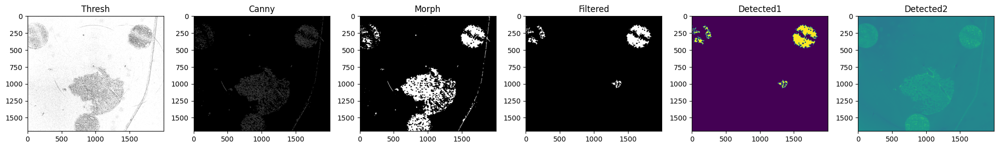

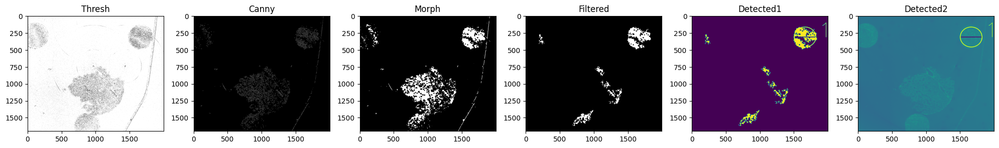

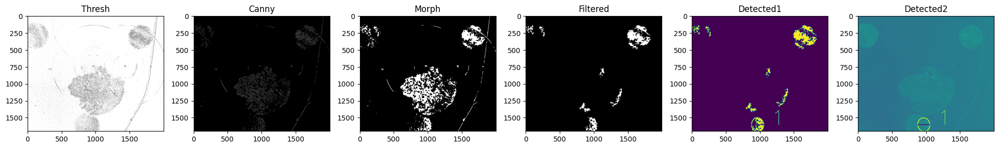

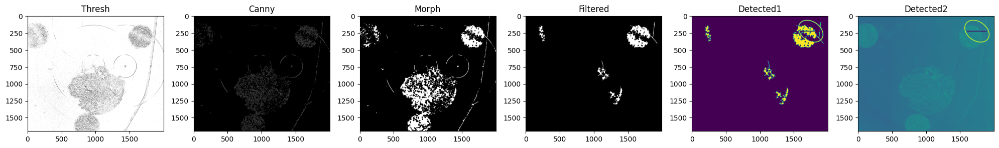

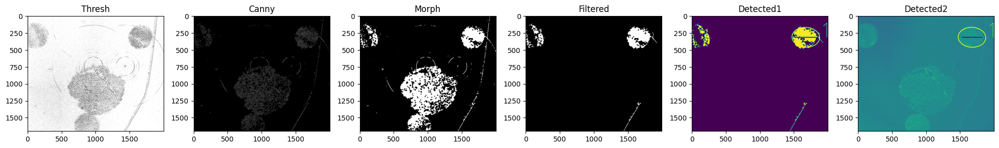

...

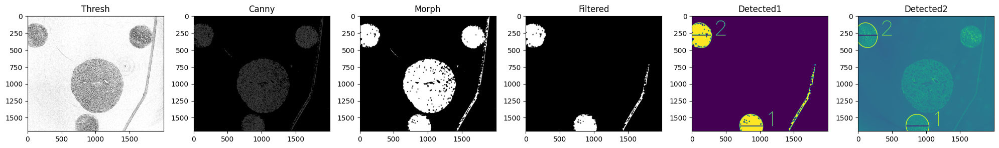

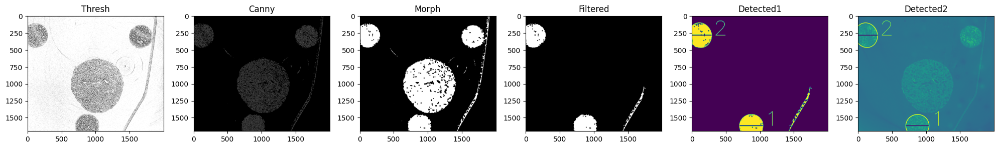

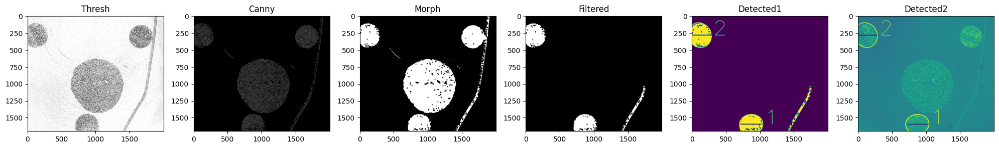

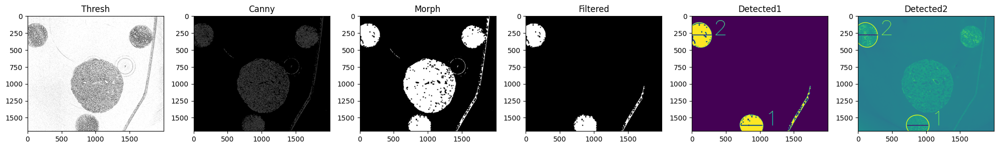

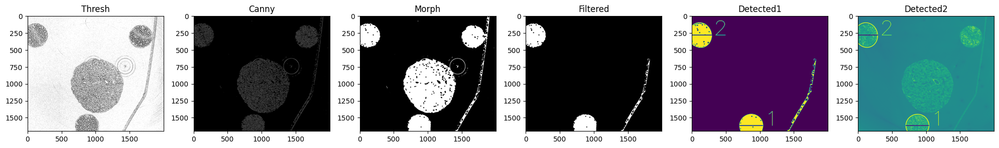

In [ ]:
df_ellips=segment_ellipses(im_list,number_of_slices)

In [ ]:
def remove_outliers(df, threshold=20):
    """
    Remove outliers from a pandas DataFrame based on a simple threshold around the median.

    For each column (except the last one, assumed to be a non-numeric identifier such as slice index),
    values that fall outside the range [median - threshold, median + threshold] are considered outliers 
    and replaced with None (NaN).
    """
    # Calculate the median and MAD for each column
    
    for column in df.columns[:-1]:
        # Calculate the median and MAD for the column
        median = df[column].median()
        #mad = df[column].mad()
        print(column)
        # Calculate the lower and upper bounds
        lower_bound = median - threshold 
        upper_bound = median + threshold
        print(lower_bound,upper_bound)

        # Replace outliers with NaN
        i = 0
        for value in df[column]:
          
            if value is None or lower_bound<value< upper_bound:
                i = i+1
                continue 
            df.iloc[i,df.columns.get_loc(column)] = None
      
            i = i+1
   
    return df

In [ ]:
def reassign_centers(df):
    """
    Reassigns misaligned center coordinates in a DataFrame of detected objects.

    This function identifies center coordinates (x, y) that are too far 
    from the median center positions and attempts to reassign them to 
    the correct column based on proximity to median coordinates. 
    """
    
    df_temp = df.copy()
    df_temp_write = df.copy()
    #print(df_temp)
    slices_w_changes =pd.DataFrame(columns=["start", "finish","slice_index"])
    df_wrong_center = pd.DataFrame(columns=["centerx", "centery","slice_index"])
    #print(df)
    center_coordinates = []
    for column in df.columns[:6]:
        median = df[column].median()
        center_coordinates.append(median)
    iv = 0
    #print(center_coordinates)
    for i in range(0,df.shape[1]-1,2):
       # print(i)
        for j in range(df.shape[0]):
          
          if (df.iloc[j,i] == None or df.iloc[j,i+1]== None):
                continue
          #print(df.iloc[j,i+1])
          x_diff = abs(df.iloc[j,i]-center_coordinates[iv])
          #print(i)
          #print(iv)
          y_diff = abs(df.iloc[j,i+1]-center_coordinates[iv+1])
          #print(df.iloc[j,i+1],center_coordinates[iv+1])
          #print(df.iloc[j,i],center_coordinates[iv])
          
          if   x_diff > 100 or y_diff >100:
              #print(x_diff,y_diff)
              new_row = {'centerx': df.iloc[j,i], 'centery': df.iloc[j,i+1], 'slice_index': df_temp .iloc[j,-1]}
              #print(new_row)
              df_wrong_center.loc[len(df_wrong_center)] = new_row
              #print(df_wrong_center.head())
            
        
        iv = iv+2
    ir = 0   #index row
    print(df_wrong_center)
    for value in df_wrong_center.iloc[:,0]:
        print("ir: "+str(ir))
        
        for i in range(0,len(center_coordinates),2):
            #print(abs(value-center_coordinates[i]))
            if(abs(value-center_coordinates[i])<100):
                #print(i)
                #print("ir"+str(ir))
                #print("Value: "+str(value))
                #print("CenterX: "+str(center_coordinates[i]))
                ##print("hi")
                #print("slice number: "+str(df_wrong_center.iloc[ir,-1]))
                rows_with_value = df_temp[df_temp['slice_index'] == df_wrong_center.iloc[ir,-1]].fillna(0)
                #print(rows_with_value)
                #print(rows_with_value)
                #print(rows_with_value.iloc[0].sub(value))
                col_index = rows_with_value.iloc[0].sub(value).abs().idxmin()
                col_index = rows_with_value.columns.get_loc(col_index)
                #print("col_indes"+str(col_index))
                
                rows_with_value.iloc[0,col_index] = None
                rows_with_value.iloc[0,i] = value
                rows_with_value.iloc[0,i+1] = rows_with_value.iloc[0,col_index+1]
                rows_with_value.iloc[0,col_index+1] = None
                #print( rows_with_value)
                loc = df_temp['slice_index'] == df_wrong_center.iloc[ir,-1]
                df_temp_write.loc[loc] = rows_with_value
                
                row_with_changes =[df_temp.columns[col_index],df_temp.columns[i],df_wrong_center.iloc[ir,-1]]
                slices_w_changes.loc[len(slices_w_changes)] =row_with_changes
                #print(df_temp)
                print( row_with_changes)
        ir = ir +1
        
        
    return df_temp_write, slices_w_changes
            

In [ ]:
#Create dataframe with just the centers 

df_centers = df_ellips.iloc[:, 3:].copy()
df_centers.head()

,center1x,center1y,center2x,center2y,center3x,center3y,slice_index
0,None,None,None,None,None,None,1
1,1662.25,319.074,None,None,None,None,5
2,978.174,1608.82,None,None,None,None,9
3,1710.36,295.601,None,None,None,None,13
4,1673.71,322.517,None,None,None,None,17


         centerx      centery slice_index
0    1662.250366   319.073761           5
1     978.173828  1608.817871           9
2    1710.362549   295.601013          13
3    1673.714233   322.517120          17
4    1432.286987   745.643250          21
5    1657.184937   313.606720          26
6    1652.979370   324.899689          30
7    1655.838013   313.679260          34
8    1660.113647   315.949677          38
9    1654.296509   327.570923          42
10   1652.490479   309.635834          47
11   1660.793457   315.813965          51
12    144.341675   294.289124          55
13   1650.454468   316.224731          59
14    754.624817  1066.552734          63
15   1654.143066   316.997192          68
16   1662.364014   307.543732          72
17   1661.458984   312.581421          76
18   1662.145630   309.666931          84
19   1660.771729   313.994202          88
20   1652.473877   311.710175          93
21   1662.482666   313.102112          97
22    106.024773   283.427521     

['center1x', 'center2x', 1677]
ir: 41
['center1x', 'center2x', 1681]
ir: 42
['center1x', 'center2x', 1685]
ir: 43
['center1x', 'center2x', 1689]
ir: 44
['center1x', 'center2x', 1693]
ir: 45
['center1x', 'center2x', 1698]
ir: 46
['center1x', 'center2x', 1702]
ir: 47
['center1x', 'center2x', 1706]
ir: 48
['center1x', 'center2x', 1710]
ir: 49
['center1x', 'center2x', 1714]
ir: 50
['center1x', 'center2x', 1719]
ir: 51
['center1x', 'center2x', 1723]
ir: 52
['center1x', 'center2x', 1727]
ir: 53
['center1x', 'center2x', 1731]
ir: 54
['center1x', 'center3x', 1735]
ir: 55
['center1x', 'center2x', 1740]
ir: 56
['center1x', 'center2x', 1744]
ir: 57
['center1x', 'center2x', 1748]
ir: 58
['center1x', 'center3x', 1752]
ir: 59
['center1x', 'center3x', 1756]
ir: 60
['center1x', 'center2x', 1760]
ir: 61
['center1x', 'center3x', 1765]
ir: 62
['center1x', 'center3x', 1769]
ir: 63
['center1x', 'center2x', 1773]
ir: 64
['center1x', 'center2x', 1777]
ir: 65
['center1x', 'center2x', 1781]
ir: 66
['center1x',

['center3x', 'center2x', 1974]
ir: 288
['center3x', 'center2x', 1987]
ir: 289
['center3x', 'center2x', 1991]
ir: 290
['center3x', 'center2x', 1995]
ir: 291
['center3x', 'center2x', 1999]
ir: 292
['center3x', 'center2x', 2004]
ir: 293
['center3x', 'center2x', 2008]
ir: 294
['center3x', 'center2x', 2012]
ir: 295
['center3x', 'center2x', 2016]
ir: 296
['center3x', 'center2x', 2020]
ir: 297
['center3x', 'center2x', 2024]
ir: 298
['center3x', 'center2x', 2029]
ir: 299
['center3x', 'center2x', 2033]
ir: 300
['center3x', 'center2x', 2037]
ir: 301
['center3x', 'center2x', 2041]
ir: 302
['center3x', 'center2x', 2045]
ir: 303
['center3x', 'center2x', 2050]
ir: 304
['center3x', 'center2x', 2054]
ir: 305
['center3x', 'center2x', 2058]
ir: 306
['center3x', 'center2x', 2062]
ir: 307
['center3x', 'center2x', 2066]
ir: 308
['center3x', 'center2x', 2071]
ir: 309
['center3x', 'center2x', 2079]
ir: 310
['center3x', 'center2x', 2083]
ir: 311
['center3x', 'center2x', 2087]
ir: 312
['center3x', 'center2x', 

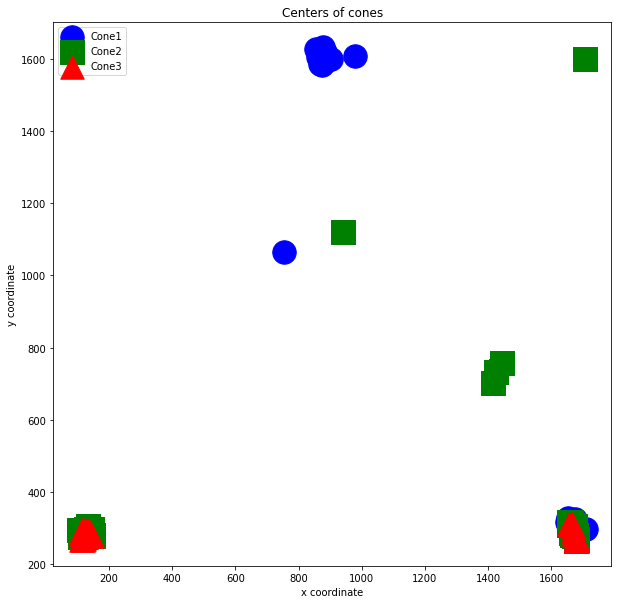

In [ ]:
#Reassign mislabeled centers in the DataFrame based on proximity to median positions
df_new_centers,changes_log = reassign_centers(df_centers)

plt.figure(figsize=(10, 10))
plt.scatter(df_centers.iloc[:, 0] , df_centers.iloc[:, 1], s=550, c="blue", marker="o", alpha=None, label="Cone1")
plt.scatter(df_centers.iloc[:, 2] , df_centers.iloc[:, 3], s=550, c="green", marker="s", alpha=None, label="Cone2")
plt.scatter(df_centers.iloc[:, 4] , df_centers.iloc[:, 5], s=550, c="red", marker="^", alpha=None, label="Cone3")

plt.xlabel("x coordinate")
plt.ylabel("y coordinate")
plt.title("Centers of cones")
plt.legend()
plt.show()


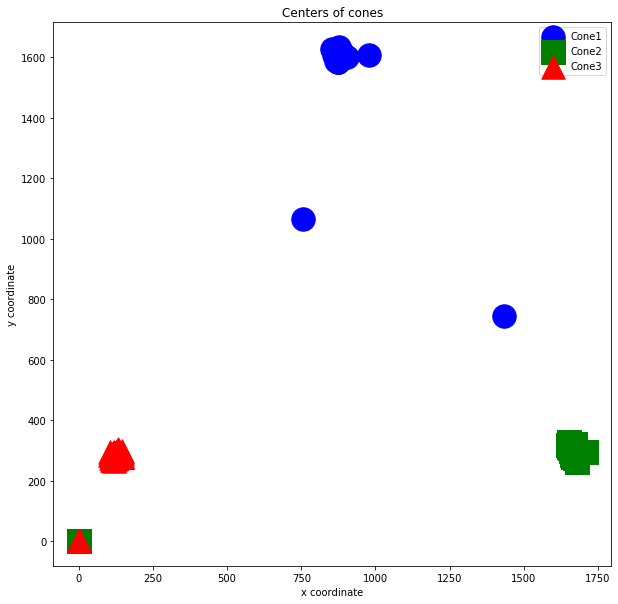

In [81]:
plt.figure(figsize=(10, 10))
plt.scatter(df_new_centers.iloc[:, 0] , df_new_centers.iloc[:, 1], s=550, c="blue", marker="o", alpha=None, label="Cone1")
plt.scatter(df_new_centers.iloc[:, 2] , df_new_centers.iloc[:, 3], s=550, c="green", marker="s", alpha=None, label="Cone2")
plt.scatter(df_new_centers.iloc[:, 4] , df_new_centers.iloc[:, 5], s=550, c="red", marker="^", alpha=None, label="Cone3")

plt.xlabel("x coordinate")
plt.ylabel("y coordinate")
plt.title("Centers of cones")
plt.legend()
plt.show()


center1x
826.65966796875 926.65966796875
center1y
1560.6710205078125 1660.6710205078125
center2x
1619.9830322265625 1719.9830322265625
center2y
238.6409912109375 338.6409912109375
center3x
76.26255798339844 176.26255798339844
center3y
233.51522827148438 333.5152282714844


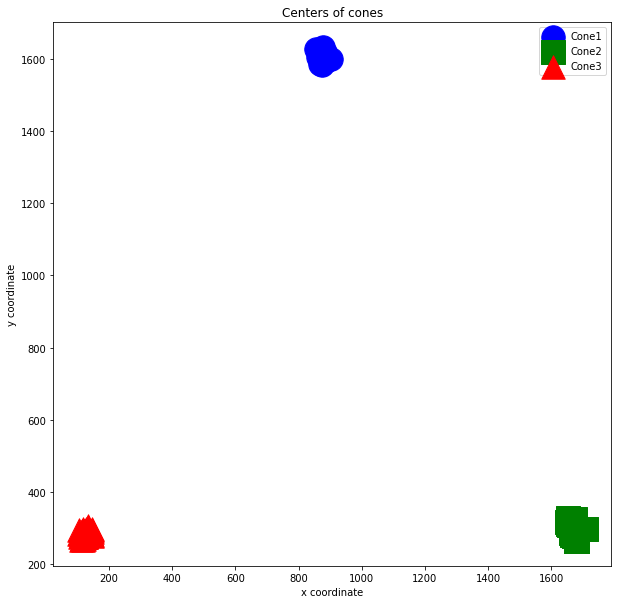

In [ ]:
# Plot the cleaned cone centers after removing outliers.
df_centers_cleaned = remove_outliers(df_new_centers,threshold =50)
plt.figure(figsize=(10, 10))
plt.scatter(df_centers_cleaned.iloc[:, 0] , df_centers_cleaned.iloc[:, 1], s=550, c="blue", marker="o", alpha=None, label="Cone1")
plt.scatter(df_centers_cleaned.iloc[:, 2] , df_centers_cleaned.iloc[:, 3], s=550, c="green", marker="s", alpha=None, label="Cone2")
plt.scatter(df_centers_cleaned.iloc[:, 4] , df_centers_cleaned.iloc[:, 5], s=550, c="red", marker="^", alpha=None, label="Cone3")

plt.xlabel("x coordinate")
plt.ylabel("y coordinate")
plt.title("Centers of cones")
plt.legend()
plt.show()

In [83]:
print(df_centers_cleaned)
print(df_new_centers)

    center1x center1y center2x center2y center3x center3y slice_index
0       None     None     None     None     None     None           1
1       None     None  1662.25  319.074     None     None           5
2       None  1608.82     None     None     None     None           9
3       None     None  1710.36  295.601     None     None          13
4       None     None  1673.71  322.517     None     None          17
5       None     None  1658.57  312.421     None     None          21
6       None     None     None     None  145.185  296.957          26
7       None     None     None     None  131.661  303.543          30
8       None     None     None     None  142.042  290.083          34
9       None     None     None     None  133.081  295.427          38
10      None     None   1654.3  327.571     None     None          42
11      None     None  1652.49  309.636     None     None          47
12      None     None     None     None  131.012  289.457          51
13      None     Non

In [ ]:
# Restore the 'slice_index' column in the cleaned DataFrame and identify
# rows where any center coordinates are missing (NaN/None). 
df_centers_cleaned.iloc[:,-1] = df_new_centers.iloc[:,-1]
indices_with_none = df_centers_cleaned[df_centers_cleaned.isna().any(axis=1)].index
print(indices_with_none)

Int64Index([  0,   1,   2,   3,   4,   5,   6,   7,   8,   9,
            ...
            490, 491, 492, 493, 494, 495, 496, 497, 498, 499],
           dtype='int64', length=236)


In [85]:
print(df_centers_cleaned)

    center1x center1y center2x center2y center3x center3y slice_index
0       None     None     None     None     None     None           1
1       None     None  1662.25  319.074     None     None           5
2       None  1608.82     None     None     None     None           9
3       None     None  1710.36  295.601     None     None          13
4       None     None  1673.71  322.517     None     None          17
5       None     None  1658.57  312.421     None     None          21
6       None     None     None     None  145.185  296.957          26
7       None     None     None     None  131.661  303.543          30
8       None     None     None     None  142.042  290.083          34
9       None     None     None     None  133.081  295.427          38
10      None     None   1654.3  327.571     None     None          42
11      None     None  1652.49  309.636     None     None          47
12      None     None     None     None  131.012  289.457          51
13      None     Non

In [ ]:
# Apply corrections to the main ellipse DataFrame based on a log of changes.
# 
# Steps:
# 1. Create copies of the original DataFrames to preserve the raw data.
# 2. Convert the first two columns of the changes log to digits only (to ensure proper indexing).
# 3. Sort the changes log by 'slice_index' to process slices in order.
# 4. Iterate through each unique slice:
#    - Filter the changes relevant to the current slice.
#    - For each change, update the corresponding column and center coordinates in df_temp_write.
#    - Track which columns have been updated and set any remaining columns to None.
# 5. Print intermediate updates for debugging, showing both before and after states.
# 
# This ensures that any mislabeled or misassigned ellipse widths and centers are correctly 
# reassigned according to the changes log, maintaining consistency across slices.


# Create copies of original DataFrames
df_temp = df_ellips.copy()
df_temp_write = df_ellips.copy()
changes_log_num = changes_log.copy()

# Convert column values to retain only digits (for the first two columns)
for column in changes_log.columns[:2]:
    changes_log_num[column] = changes_log[column].apply(lambda x: ''.join(filter(str.isdigit, str(x))))

# Sort the changes_log by 'slice_index'
changes_log_num = changes_log_num.sort_values(by='slice_index')

# Iterate through unique 'slice_index' values
for index in changes_log_num['slice_index'].unique():
    # Filter changes for the current 'slice_index'
    filtered_changes = changes_log_num[changes_log_num['slice_index'] == index]
    changed_entries = {0, 1, 2}  # Track columns to update

    for idx_cl, row in filtered_changes.iterrows():
        index_filtered = row['slice_index']
        column_index = int(row.iloc[0]) - 1   # Adjust for zero-based indexing
        column_index2 = int(row.iloc[1]) - 1  # Adjust for zero-based indexing
        
        # Find the corresponding row in df_temp
        search_row = df_temp[df_temp['slice_index'] == index_filtered]
        
        if not search_row.empty:
            # Update df_temp_write with the value from df_temp
            print(f"column_index: {column_index}")
            print(f"Before update: {df_temp_write[df_temp_write['slice_index'] == index_filtered]}")
            print(f"Updating column: {df_temp_write.columns[column_index2]}")
            
            # First update for the given column
            df_temp_write.loc[df_temp_write['slice_index'] == index_filtered, df_temp_write.columns[column_index2]] = search_row.iloc[0, column_index]
            changed_entries.discard(column_index2)  # Remove updated column from 'changed_entries'
            
            # Define your center_index matrix for subsequent updates
            center_index = [[3, 4], [5, 6], [7, 8]]
            
            # Ensure column_index and column_index2 are within bounds of center_index
            if column_index < len(center_index) and column_index2 < len(center_index):
                df_temp_write.loc[df_temp_write['slice_index'] == index_filtered, df_temp_write.columns[center_index[column_index2][0]]] = search_row.iloc[0, center_index[column_index][0]]
                df_temp_write.loc[df_temp_write['slice_index'] == index_filtered, df_temp_write.columns[center_index[column_index2][1]]] = search_row.iloc[0, center_index[column_index][1]]
        
        # Print the updated row for debugging
        print(f"Updated row for slice_index {index_filtered}: {df_temp_write[df_temp_write['slice_index'] == index_filtered]}")

    # Handle any remaining columns (those that were not updated)
    for remaining_col in changed_entries:
        print(f"remaining_col IN INDEX {index} {remaining_col}")
        df_temp_write.loc[df_temp_write['slice_index'] == index, df_temp_write.columns[remaining_col]] = None
        
        # Update the corresponding center_index values to None
        if remaining_col < len(center_index):
            df_temp_write.loc[df_temp_write['slice_index'] == index_filtered, df_temp_write.columns[center_index[remaining_col][0]]] = None
            df_temp_write.loc[df_temp_write['slice_index'] == index_filtered, df_temp_write.columns[center_index[remaining_col][1]]] = None
        
        # Print to show the row with updated values
        print(f"After setting None for remaining column: {df_temp_write[df_temp_write['slice_index'] == index_filtered]}")


column_index: 0
Before update:      cone1 cone2 cone3 center1x center1y center2x center2y center3x center3y  \
1  290.287  None  None  1662.25  319.074     None     None     None     None   

  slice_index  
1           5  
Updating column: cone2
Updated row for slice_index 5:      cone1    cone2 cone3 center1x center1y center2x center2y center3x  \
1  290.287  290.287  None  1662.25  319.074  1662.25  319.074     None   

  center3y slice_index  
1     None           5  
remaining_col IN INDEX 5 0
After setting None for remaining column:   cone1    cone2 cone3 center1x center1y center2x center2y center3x center3y  \
1  None  290.287  None     None     None  1662.25  319.074     None     None   

  slice_index  
1           5  
remaining_col IN INDEX 5 2
After setting None for remaining column:   cone1    cone2 cone3 center1x center1y center2x center2y center3x center3y  \
1  None  290.287  None     None     None  1662.25  319.074     None     None   

  slice_index  
1           5  
c

Before update:      cone1 cone2 cone3 center1x center1y center2x center2y center3x center3y  \
14  309.88  None  None  1650.45  316.225     None     None     None     None   

   slice_index  
14          59  
Updating column: cone2
Updated row for slice_index 59:      cone1   cone2 cone3 center1x center1y center2x center2y center3x  \
14  309.88  309.88  None  1650.45  316.225  1650.45  316.225     None   

   center3y slice_index  
14     None          59  
remaining_col IN INDEX 59 0
After setting None for remaining column:    cone1   cone2 cone3 center1x center1y center2x center2y center3x center3y  \
14  None  309.88  None     None     None  1650.45  316.225     None     None   

   slice_index  
14          59  
remaining_col IN INDEX 59 2
After setting None for remaining column:    cone1   cone2 cone3 center1x center1y center2x center2y center3x center3y  \
14  None  309.88  None     None     None  1650.45  316.225     None     None   

   slice_index  
14          59  
column_i

After setting None for remaining column:    cone1 cone2    cone3 center1x center1y center2x center2y center3x center3y  \
24  None  None  314.932     None     None     None     None  106.025  283.428   

   slice_index  
24         101  
remaining_col IN INDEX 101 1
After setting None for remaining column:    cone1 cone2    cone3 center1x center1y center2x center2y center3x center3y  \
24  None  None  314.932     None     None     None     None  106.025  283.428   

   slice_index  
24         101  
column_index: 1
Before update:       cone1    cone2 cone3 center1x center1y center2x center2y center3x  \
26  296.089  323.458  None   867.45  1602.37  134.377  292.309     None   

   center3y slice_index  
26     None         109  
Updating column: cone3
Updated row for slice_index 109:       cone1    cone2    cone3 center1x center1y center2x center2y center3x  \
26  296.089  323.458  323.458   867.45  1602.37  134.377  292.309  134.377   

   center3y slice_index  
26  292.309         10

Updated row for slice_index 231:       cone1    cone2    cone3 center1x center1y center2x center2y center3x  \
55  336.793  330.788  330.788  875.149  1620.68   123.17  286.806   123.17   

   center3y slice_index  
55  286.806         231  
remaining_col IN INDEX 231 0
After setting None for remaining column:    cone1    cone2    cone3 center1x center1y center2x center2y center3x  \
55  None  330.788  330.788     None     None   123.17  286.806   123.17   

   center3y slice_index  
55  286.806         231  
remaining_col IN INDEX 231 1
After setting None for remaining column:    cone1 cone2    cone3 center1x center1y center2x center2y center3x center3y  \
55  None  None  330.788     None     None     None     None   123.17  286.806   

   slice_index  
55         231  
column_index: 1
Before update:       cone1    cone2 cone3 center1x center1y center2x center2y center3x  \
56  260.945  336.521  None  873.882  1585.99  115.499  288.011     None   

   center3y slice_index  
56     Non

Updating column: cone3
Updated row for slice_index 281:       cone1    cone2    cone3 center1x center1y center2x center2y center3x  \
67  279.728  328.533  328.533  875.001  1597.59  124.755  289.037  124.755   

   center3y slice_index  
67  289.037         281  
remaining_col IN INDEX 281 0
After setting None for remaining column:    cone1    cone2    cone3 center1x center1y center2x center2y center3x  \
67  None  328.533  328.533     None     None  124.755  289.037  124.755   

   center3y slice_index  
67  289.037         281  
remaining_col IN INDEX 281 1
After setting None for remaining column:    cone1 cone2    cone3 center1x center1y center2x center2y center3x center3y  \
67  None  None  328.533     None     None     None     None  124.755  289.037   

   slice_index  
67         281  
column_index: 1
Before update:      cone1    cone2 cone3 center1x center1y center2x center2y center3x  \
68  286.56  319.742  None  875.422  1601.18  124.001  287.841     None   

   center3y sli

After setting None for remaining column:    cone1    cone2    cone3 center1x center1y center2x center2y center3x  \
78  None  328.765  328.765     None     None  121.733  286.671  121.733   

   center3y slice_index  
78  286.671         327  
remaining_col IN INDEX 327 1
After setting None for remaining column:    cone1 cone2    cone3 center1x center1y center2x center2y center3x center3y  \
78  None  None  328.765     None     None     None     None  121.733  286.671   

   slice_index  
78         327  
column_index: 1
Before update:       cone1    cone2 cone3 center1x center1y center2x center2y center3x  \
79  276.718  330.359  None  872.857  1598.67  121.509  287.965     None   

   center3y slice_index  
79     None         332  
Updating column: cone3
Updated row for slice_index 332:       cone1    cone2    cone3 center1x center1y center2x center2y center3x  \
79  276.718  330.359  330.359  872.857  1598.67  121.509  287.965  121.509   

   center3y slice_index  
79  287.965     

Updating column: cone2
Updated row for slice_index 386:       cone1    cone2 cone3 center1x center1y center2x center2y center3x  \
92  291.462  291.462  None  1658.12  305.273  1658.12  305.273     None   

   center3y slice_index  
92     None         386  
column_index: 1
Before update:       cone1    cone2 cone3 center1x center1y center2x center2y center3x  \
92  291.462  291.462  None  1658.12  305.273  1658.12  305.273     None   

   center3y slice_index  
92     None         386  
Updating column: cone3
Updated row for slice_index 386:       cone1    cone2    cone3 center1x center1y center2x center2y center3x  \
92  291.462  291.462  321.337  1658.12  305.273  1658.12  305.273  119.869   

   center3y slice_index  
92  281.274         386  
remaining_col IN INDEX 386 0
After setting None for remaining column:    cone1    cone2    cone3 center1x center1y center2x center2y center3x  \
92  None  291.462  321.337     None     None  1658.12  305.273  119.869   

   center3y slice_ind

remaining_col IN INDEX 440 1
After setting None for remaining column:     cone1 cone2    cone3 center1x center1y center2x center2y center3x  \
105  None  None  326.192     None     None     None     None  108.058   

    center3y slice_index  
105  273.656         440  
column_index: 1
Before update:        cone1    cone2 cone3 center1x center1y center2x center2y center3x  \
106  287.433  319.512  None  876.483  1609.17  120.076  284.865     None   

    center3y slice_index  
106     None         445  
Updating column: cone3
Updated row for slice_index 445:        cone1    cone2    cone3 center1x center1y center2x center2y center3x  \
106  287.433  319.512  319.512  876.483  1609.17  120.076  284.865  120.076   

    center3y slice_index  
106  284.865         445  
remaining_col IN INDEX 445 0
After setting None for remaining column:     cone1    cone2    cone3 center1x center1y center2x center2y center3x  \
106  None  319.512  319.512     None     None  120.076  284.865  120.076   


After setting None for remaining column:     cone1    cone2    cone3 center1x center1y center2x center2y center3x  \
145  None  305.618  305.618     None     None  120.548  285.505  120.548   

    center3y slice_index  
145  285.505         608  
remaining_col IN INDEX 608 1
After setting None for remaining column:     cone1 cone2    cone3 center1x center1y center2x center2y center3x  \
145  None  None  305.618     None     None     None     None  120.548   

    center3y slice_index  
145  285.505         608  
column_index: 1
Before update:        cone1    cone2 cone3 center1x center1y center2x center2y center3x  \
146  242.193  308.591  None  874.971  1598.82  117.823   284.78     None   

    center3y slice_index  
146     None         612  
Updating column: cone3
Updated row for slice_index 612:        cone1    cone2    cone3 center1x center1y center2x center2y center3x  \
146  242.193  308.591  308.591  874.971  1598.82  117.823   284.78  117.823   

    center3y slice_index  
1

Before update:        cone1    cone2 cone3 center1x center1y center2x center2y center3x  \
215  251.646  259.019  None  1670.93  299.312  126.263  276.986     None   

    center3y slice_index  
215     None         901  
Updating column: cone3
Updated row for slice_index 901:        cone1    cone2    cone3 center1x center1y center2x center2y center3x  \
215  251.646  259.019  259.019  1670.93  299.312  126.263  276.986  126.263   

    center3y slice_index  
215  276.986         901  
column_index: 0
Before update:        cone1    cone2    cone3 center1x center1y center2x center2y center3x  \
215  251.646  259.019  259.019  1670.93  299.312  126.263  276.986  126.263   

    center3y slice_index  
215  276.986         901  
Updating column: cone2
Updated row for slice_index 901:        cone1    cone2    cone3 center1x center1y center2x center2y center3x  \
215  251.646  251.646  259.019  1670.93  299.312  1670.93  299.312  126.263   

    center3y slice_index  
215  276.986         90

Before update:        cone1    cone2 cone3 center1x center1y center2x center2y center3x  \
399  173.614  180.712  None  1674.06  280.994  138.108  280.793     None   

    center3y slice_index  
399     None        1672  
Updating column: cone3
Updated row for slice_index 1672:        cone1    cone2    cone3 center1x center1y center2x center2y center3x  \
399  173.614  180.712  180.712  1674.06  280.994  138.108  280.793  138.108   

    center3y slice_index  
399  280.793        1672  
column_index: 0
Before update:        cone1    cone2    cone3 center1x center1y center2x center2y center3x  \
399  173.614  180.712  180.712  1674.06  280.994  138.108  280.793  138.108   

    center3y slice_index  
399  280.793        1672  
Updating column: cone2
Updated row for slice_index 1672:        cone1    cone2    cone3 center1x center1y center2x center2y center3x  \
399  173.614  173.614  180.712  1674.06  280.994  1674.06  280.994  138.108   

    center3y slice_index  
399  280.793        1

Updating column: cone3
Updated row for slice_index 1714:        cone1    cone2    cone3 center1x center1y center2x center2y center3x  \
409  177.455  191.575  191.575  1677.34   276.15  138.869  281.307  138.869   

    center3y slice_index  
409  281.307        1714  
column_index: 0
Before update:        cone1    cone2    cone3 center1x center1y center2x center2y center3x  \
409  177.455  191.575  191.575  1677.34   276.15  138.869  281.307  138.869   

    center3y slice_index  
409  281.307        1714  
Updating column: cone2
Updated row for slice_index 1714:        cone1    cone2    cone3 center1x center1y center2x center2y center3x  \
409  177.455  177.455  191.575  1677.34   276.15  1677.34   276.15  138.869   

    center3y slice_index  
409  281.307        1714  
remaining_col IN INDEX 1714 0
After setting None for remaining column:     cone1    cone2    cone3 center1x center1y center2x center2y center3x  \
409  None  177.455  191.575     None     None  1677.34   276.15  138.

After setting None for remaining column:     cone1 cone2    cone3 center1x center1y center2x center2y center3x  \
418  None  None  169.494     None     None     None     None  138.689   

    center3y slice_index  
418  284.599        1752  
column_index: 0
Before update:        cone1 cone2 cone3 center1x center1y center2x center2y center3x  \
419  183.992  None  None  138.856  282.938     None     None     None   

    center3y slice_index  
419     None        1756  
Updating column: cone3
Updated row for slice_index 1756:        cone1 cone2    cone3 center1x center1y center2x center2y center3x  \
419  183.992  None  183.992  138.856  282.938     None     None  138.856   

    center3y slice_index  
419  282.938        1756  
remaining_col IN INDEX 1756 0
After setting None for remaining column:     cone1 cone2    cone3 center1x center1y center2x center2y center3x  \
419  None  None  183.992     None     None     None     None  138.856   

    center3y slice_index  
419  282.938     

Updated row for slice_index 1798:        cone1    cone2    cone3 center1x center1y center2x center2y center3x  \
429  166.305  180.608  180.608  1678.41  273.458   140.58  280.525   140.58   

    center3y slice_index  
429  280.525        1798  
column_index: 0
Before update:        cone1    cone2    cone3 center1x center1y center2x center2y center3x  \
429  166.305  180.608  180.608  1678.41  273.458   140.58  280.525   140.58   

    center3y slice_index  
429  280.525        1798  
Updating column: cone2
Updated row for slice_index 1798:        cone1    cone2    cone3 center1x center1y center2x center2y center3x  \
429  166.305  166.305  180.608  1678.41  273.458  1678.41  273.458   140.58   

    center3y slice_index  
429  280.525        1798  
remaining_col IN INDEX 1798 0
After setting None for remaining column:     cone1    cone2    cone3 center1x center1y center2x center2y center3x  \
429  None  166.305  180.608     None     None  1678.41  273.458   140.58   

    center3y sl

Updated row for slice_index 1840:        cone1    cone2    cone3 center1x center1y center2x center2y center3x  \
439  163.498  174.054  174.054   875.91  1619.27  141.981  280.338  141.981   

    center3y slice_index  
439  280.338        1840  
remaining_col IN INDEX 1840 0
After setting None for remaining column:     cone1    cone2    cone3 center1x center1y center2x center2y center3x  \
439  None  174.054  174.054     None     None  141.981  280.338  141.981   

    center3y slice_index  
439  280.338        1840  
remaining_col IN INDEX 1840 1
After setting None for remaining column:     cone1 cone2    cone3 center1x center1y center2x center2y center3x  \
439  None  None  174.054     None     None     None     None  141.981   

    center3y slice_index  
439  280.338        1840  
column_index: 1
Before update:        cone1    cone2    cone3 center1x center1y center2x center2y center3x  \
440  166.815  174.441  161.219  877.623  1617.84  141.623  280.227  1678.85   

    center3y 

Updating column: cone3
Updated row for slice_index 1907:        cone1 cone2    cone3 center1x center1y center2x center2y center3x  \
455  163.853  None  163.853  142.174  281.887     None     None  142.174   

    center3y slice_index  
455  281.887        1907  
remaining_col IN INDEX 1907 0
After setting None for remaining column:     cone1 cone2    cone3 center1x center1y center2x center2y center3x  \
455  None  None  163.853     None     None     None     None  142.174   

    center3y slice_index  
455  281.887        1907  
remaining_col IN INDEX 1907 1
After setting None for remaining column:     cone1 cone2    cone3 center1x center1y center2x center2y center3x  \
455  None  None  163.853     None     None     None     None  142.174   

    center3y slice_index  
455  281.887        1907  
column_index: 1
Before update:        cone1    cone2 cone3 center1x center1y center2x center2y center3x  \
457  153.274  163.507  None  876.484  1618.47  142.207  281.213     None   

    cent

Updated row for slice_index 1970:        cone1    cone2    cone3 center1x center1y center2x center2y center3x  \
470  153.677  159.183  159.183  876.771  1617.76  145.069  277.857  145.069   

    center3y slice_index  
470  277.857        1970  
column_index: 2
Before update:        cone1    cone2    cone3 center1x center1y center2x center2y center3x  \
470  153.677  159.183  159.183  876.771  1617.76  145.069  277.857  145.069   

    center3y slice_index  
470  277.857        1970  
Updating column: cone2
Updated row for slice_index 1970:        cone1    cone2    cone3 center1x center1y center2x center2y center3x  \
470  153.677  145.691  159.183  876.771  1617.76  1679.95  267.173  145.069   

    center3y slice_index  
470  277.857        1970  
remaining_col IN INDEX 1970 0
After setting None for remaining column:     cone1    cone2    cone3 center1x center1y center2x center2y center3x  \
470  None  145.691  159.183     None     None  1679.95  267.173  145.069   

    center3y sl

Updating column: cone3
Updated row for slice_index 2012:        cone1    cone2    cone3 center1x center1y center2x center2y center3x  \
480  147.122  154.221  154.221  876.487  1618.09  145.757  278.296  145.757   

    center3y slice_index  
480  278.296        2012  
column_index: 2
Before update:        cone1    cone2    cone3 center1x center1y center2x center2y center3x  \
480  147.122  154.221  154.221  876.487  1618.09  145.757  278.296  145.757   

    center3y slice_index  
480  278.296        2012  
Updating column: cone2
Updated row for slice_index 2012:        cone1    cone2    cone3 center1x center1y center2x center2y center3x  \
480  147.122  141.206  154.221  876.487  1618.09  1679.85  265.801  145.757   

    center3y slice_index  
480  278.296        2012  
remaining_col IN INDEX 2012 0
After setting None for remaining column:     cone1    cone2    cone3 center1x center1y center2x center2y center3x  \
480  None  141.206  154.221     None     None  1679.85  265.801  145.

Before update:        cone1    cone2    cone3 center1x center1y center2x center2y center3x  \
489  144.893  133.121  133.121  877.368  1618.09   1679.4  264.073   1679.4   

    center3y slice_index  
489  264.073        2050  
Updating column: cone3
Updated row for slice_index 2050:        cone1    cone2    cone3 center1x center1y center2x center2y center3x  \
489  144.893  133.121  149.404  877.368  1618.09   1679.4  264.073  146.817   

    center3y slice_index  
489  275.928        2050  
remaining_col IN INDEX 2050 0
After setting None for remaining column:     cone1    cone2    cone3 center1x center1y center2x center2y center3x  \
489  None  133.121  149.404     None     None   1679.4  264.073  146.817   

    center3y slice_index  
489  275.928        2050  
column_index: 2
Before update:        cone1    cone2    cone3 center1x center1y center2x center2y center3x  \
490  144.864  140.828  138.334  877.107  1617.68  144.217  277.639  1679.81   

    center3y slice_index  
490  26

In [ ]:
#Print Changes
print(changes_log)

        start    finish slice_index
0    center1x  center2x           5
1    center1x  center2x          13
2    center1x  center2x          17
3    center1x  center2x          26
4    center1x  center2x          30
5    center1x  center2x          34
6    center1x  center2x          38
7    center1x  center2x          42
8    center1x  center2x          47
9    center1x  center2x          51
10   center1x  center3x          55
11   center1x  center2x          59
12   center1x  center2x          68
13   center1x  center2x          72
14   center1x  center2x          76
15   center1x  center2x          84
16   center1x  center2x          88
17   center1x  center2x          93
18   center1x  center2x          97
19   center1x  center3x         101
20   center1x  center2x         151
21   center1x  center2x         382
22   center1x  center2x         386
23   center1x  center2x         591
24   center1x  center2x         642
25   center1x  center2x         751
26   center1x  center2x     

In [127]:
print(df_temp_write)

       cone1    cone2    cone3 center1x center1y center2x center2y center3x  \
0       None     None     None     None     None     None     None     None   
1       None  290.287     None     None     None  1662.25  319.074     None   
2    152.653     None     None  978.174  1608.82     None     None     None   
3       None  324.449     None     None     None  1710.36  295.601     None   
4       None   295.71     None     None     None  1673.71  322.517     None   
5    277.238  319.349     None  1432.29  745.643  1658.57  312.421     None   
6       None   328.03  290.065     None     None  1657.18  313.607  145.185   
7       None  318.275  268.761     None     None  1652.98    324.9  131.661   
8       None  335.308   270.57     None     None  1655.84  313.679  142.042   
9       None  332.526   280.34     None     None  1660.11   315.95  133.081   
10      None  313.579     None     None     None   1654.3  327.571     None   
11      None  322.949     None     None     None  16

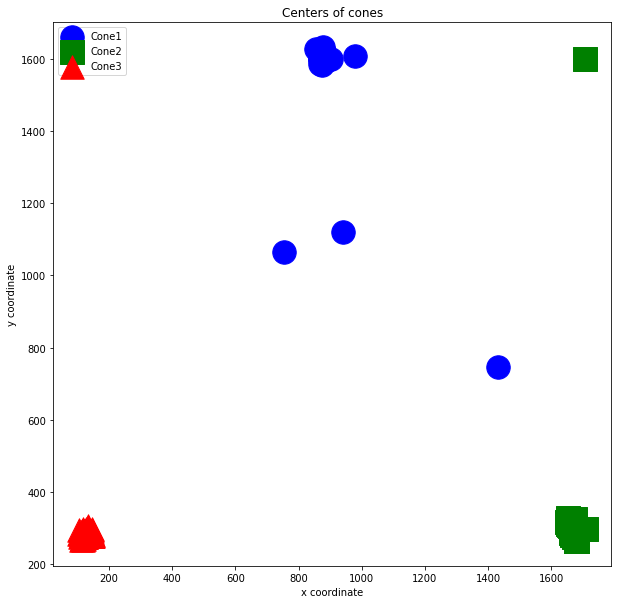

In [ ]:
#Visualize the current distribution

plt.figure(figsize=(10, 10))

plt.scatter(df_temp_write.iloc[:, 3] , df_temp_write.iloc[:, 4], s=550, c="blue", marker="o", alpha=None, label="Cone1")
plt.scatter(df_temp_write.iloc[:, 5] , df_temp_write.iloc[:, 6], s=550, c="green", marker="s", alpha=None, label="Cone2")
plt.scatter(df_temp_write.iloc[:, 7] ,df_temp_write.iloc[:, 8], s=550, c="red", marker="^", alpha=None, label="Cone3")

plt.xlabel("x coordinate")
plt.ylabel("y coordinate")
plt.title("Centers of cones")
plt.legend()
plt.show()

In [128]:
df_ellips_cleaned_width = df_temp_write.iloc[:, :3].copy()
df_ellips_cleaned_width.head()


,cone1,cone2,cone3
0,None,None,None
1,None,290.287,None
2,152.653,None,None
3,None,324.449,None
4,None,295.71,None


In [130]:
df_ellips_cleaned_centers.head()

,center1y,center2x,center2y,center3x,center3y
0,None,None,None,None,None
1,None,1662.25,319.074,None,None
2,1608.82,None,None,None,None
3,None,1710.36,295.601,None,None
4,None,1673.71,322.517,None,None


In [ ]:

# Clean the ellipse DataFrame by removing outliers separately for widths and centers:
# 1. 'df_ellips_cleaned_centers': removes outliers from center coordinates (columns 3–8) using a threshold of 20.
# 2. 'df_ellips_cleaned_width': removes outliers from ellipse widths (columns 0–2) using a threshold of 100.
# 3. Concatenate the cleaned widths, cleaned centers, and the original 'slice_index' column into a single DataFrame.
# The resulting 'df_ellips_cleaned' contains only reliable ellipse measurements for further analysis.

df_ellips_cleaned_centers = remove_outliers(df_temp_write.iloc[:,3:9].copy(), threshold=20)
df_ellips_cleaned_width = remove_outliers(df_temp_write.iloc[:, :3].copy(), threshold=100)
df_ellips_cleaned = pd.concat(
    [df_ellips_cleaned_width, df_ellips_cleaned_centers, df_temp_write.iloc[:, -1]], 
    axis=1
)

center1x
856.016845703125 896.016845703125
center1y
1591.6221923828125 1631.6221923828125
center2x
1650.3612060546875 1690.3612060546875
center2y
268.81170654296875 308.81170654296875
center3x
107.42574310302734 147.42574310302734
cone1
122.21733093261719 322.2173309326172
cone2
122.17649841308594 322.17649841308594


In [182]:
df_ellips_cleaned.head()

,cone1,cone2,cone3,center1x,center1y,center2x,center2y,center3x,center3y,slice_index
0,None,None,None,None,None,None,None,None,None,1
1,None,290.287,None,None,None,1662.25,None,None,None,5
2,152.653,None,None,None,1608.82,None,None,None,None,9
3,None,None,None,None,None,None,295.601,None,None,13
4,None,295.71,None,None,None,1673.71,None,None,None,17


In [183]:
df_ellips_cleaned.head()
df_ellips_cleaned_cones = df_ellips_cleaned[df_ellips_cleaned.columns[:3]].copy()
df_ellips_cleaned_cones.head()

,cone1,cone2,cone3
0,None,None,None
1,None,290.287,None
2,152.653,None,None
3,None,None,None
4,None,295.71,None


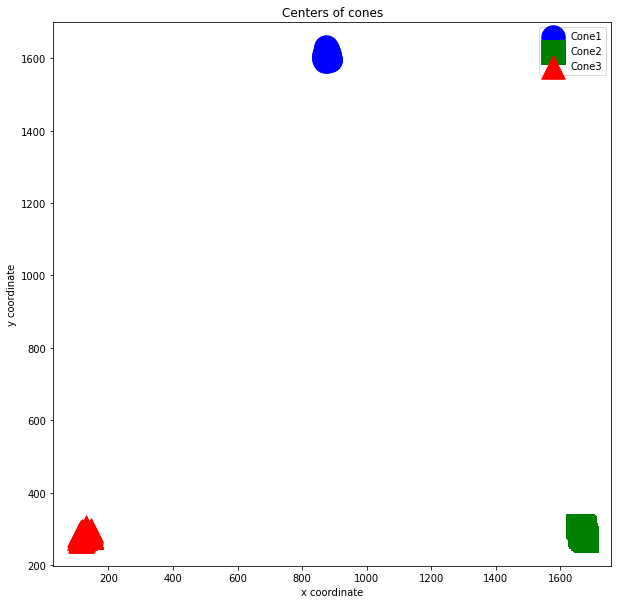

In [ ]:
#Visualize final Centers
plt.figure(figsize=(10, 10))

plt.scatter(df_ellips_cleaned.iloc[:, 3] , df_ellips_cleaned.iloc[:, 4], s=550, c="blue", marker="o", alpha=None, label="Cone1")
plt.scatter(df_ellips_cleaned.iloc[:, 5] , df_ellips_cleaned.iloc[:, 6], s=550, c="green", marker="s", alpha=None, label="Cone2")
plt.scatter(df_ellips_cleaned.iloc[:, 7] ,df_ellips_cleaned.iloc[:, 8], s=550, c="red", marker="^", alpha=None, label="Cone3")

plt.xlabel("x coordinate")
plt.ylabel("y coordinate")
plt.title("Centers of cones")
plt.legend()
plt.show()

In [185]:
print(df_ellips_cleaned)


       cone1    cone2    cone3 center1x center1y center2x center2y center3x  \
0       None     None     None     None     None     None     None     None   
1       None  290.287     None     None     None  1662.25     None     None   
2    152.653     None     None     None  1608.82     None     None     None   
3       None     None     None     None     None     None  295.601     None   
4       None   295.71     None     None     None  1673.71     None     None   
5    277.238  319.349     None     None     None  1658.57     None     None   
6       None     None  290.065     None     None  1657.18     None  145.185   
7       None  318.275  268.761     None     None  1652.98     None  131.661   
8       None     None   270.57     None     None  1655.84     None  142.042   
9       None     None   280.34     None     None  1660.11     None  133.081   
10      None  313.579     None     None     None   1654.3     None     None   
11      None     None     None     None     None  16

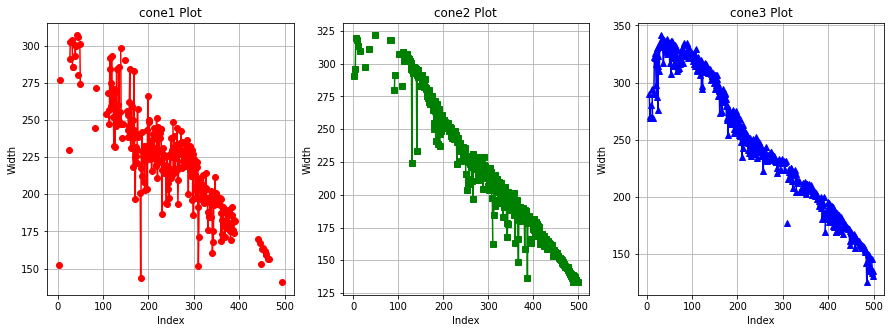

In [ ]:
# Plot the widths of the three cones across all slices.
fig, axes = plt.subplots(nrows=1, ncols=3, figsize=(15, 5))  # Adjust figsize as needed

# Plot each column in its own subplot
axes[0].plot(df_ellips_cleaned_cones["cone1"], marker="o", color="r", label="cone1")
axes[0].set_title("cone1 Plot")
axes[0].set_xlabel("Index")
axes[0].set_ylabel("Width")
axes[0].grid(True)

axes[1].plot(df_ellips_cleaned_cones["cone2"], marker="s", color="g", label="cone2")
axes[1].set_title("cone2 Plot")
axes[1].set_xlabel("Index")
axes[1].set_ylabel("Width")
axes[1].grid(True)

axes[2].plot(df_ellips_cleaned_cones["cone3"], marker="^", color="b", label="cone3")
axes[2].set_title("cone3 Plot")
axes[2].set_xlabel("Index")
axes[2].set_ylabel("Width")
axes[2].grid(True)


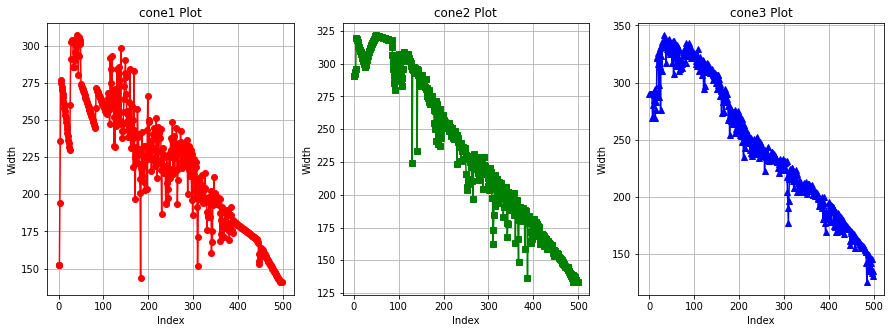

In [187]:
# Smooth the cleaned cone width data by interpolating missing values:
# 1. Convert all columns to float and apply linear interpolation for NaNs.
# 2. Backfill any remaining missing values to ensure no gaps remain.

df_smoothed = df_ellips_cleaned_cones.astype(float).interpolate()
df_smoothed = df_smoothed.bfill().where(df_smoothed.isna(), df_smoothed)

fig, axes = plt.subplots(nrows=1, ncols=3, figsize=(15, 5))  # Adjust figsize as needed
# Plot each column in its own subplot
axes[0].plot(df_smoothed["cone1"], marker="o", color="r", label="cone1")
axes[0].set_title("cone1 Plot")
axes[0].set_xlabel("Index")
axes[0].set_ylabel("Width")
axes[0].grid(True)

axes[1].plot(df_smoothed["cone2"], marker="s", color="g", label="cone2")
axes[1].set_title("cone2 Plot")
axes[1].set_xlabel("Index")
axes[1].set_ylabel("Width")
axes[1].grid(True)

axes[2].plot(df_smoothed["cone3"], marker="^", color="b", label="cone3")
axes[2].set_title("cone3 Plot")
axes[2].set_xlabel("Index")
axes[2].set_ylabel("Width")
axes[2].grid(True)


In [ ]:
print(df_smoothed*0.004)

        cone1     cone2     cone3
0    0.915917  1.741724  1.740392
1    0.915917  1.741724  1.740392
2    0.915917  1.752570  1.740392
3    1.165086  1.763416  1.740392
4    1.414256  1.774261  1.740392
5    1.663426  1.916093  1.740392
6    1.649138  1.912870  1.740392
7    1.634850  1.909647  1.612564
8    1.620563  1.900256  1.623422
9    1.606275  1.890866  1.682042
10   1.591988  1.881475  1.709701
11   1.577700  1.875926  1.737360
12   1.563413  1.870377  1.765019
13   1.549125  1.864828  1.614900
14   1.534837  1.859279  1.657022
15   1.520550  1.852461  1.699144
16   1.506262  1.845643  1.741266
17   1.491975  1.838826  1.936156
18   1.477687  1.832008  1.926994
19   1.463399  1.825190  1.955743
20   1.449112  1.818372  1.897861
21   1.434824  1.811554  1.785545
22   1.420537  1.804737  1.724092
23   1.406249  1.797919  1.982955
24   1.391961  1.791101  1.889593
25   1.377674  1.784283  1.658552
26   1.562041  1.792702  1.940748
27   1.746409  1.801122  1.992196
28   1.815635 

In [ ]:

def width_interpolation_with_second_regression(df_ellips_cleaned, number_of_slices, threshold_factor=1):
     """
    Perform a two-step linear regression on cone width data to smooth measurements 
    and identify outliers, then plot the results.
     """
     
    # Lists to store results for each column
    first_regression_smooth = []
    second_regression_smooth = []
    inlier_y_list = []
    inlier_x_list = []
    
    # Convert DataFrame to float and number_of_slices to a NumPy array
    df_temp = df_ellips_cleaned.astype(float)
    number_of_slices = np.array(number_of_slices, dtype=float)
    
    # Ensure consistency between the data and number_of_slices
    if len(number_of_slices) != len(df_temp):
        raise ValueError(f"Mismatch: number_of_slices has {len(number_of_slices)} values, "
                         f"but DataFrame has {len(df_temp)} rows.")

    # Create a smooth range for plotting the regression lines
    x = np.linspace(np.min(number_of_slices), np.max(number_of_slices), 100)
    
    # Process each column independently
    for col in df_temp.columns:
        y = df_temp[col].to_numpy()
        
        # ----- First Regression (using all data) -----
        coeff_first = np.polyfit(number_of_slices, y, 1)
        slope_first, intercept_first = coeff_first
        y_fit_all = slope_first * number_of_slices + intercept_first
        y_fit_first_smooth = slope_first * x + intercept_first  # smooth line for plotting
        
        # Calculate residuals and determine a threshold
        residuals = y - y_fit_all
        mse = np.mean(residuals**2)
        threshold = threshold_factor * np.sqrt(mse)
        
        # Identify inliers
        inlier_mask = np.abs(residuals) <= threshold
        x_inliers = number_of_slices[inlier_mask]
        y_inliers = y[inlier_mask]
        
        # ----- Second Regression (using only inliers) -----
        if len(x_inliers) > 1:
            coeff_second = np.polyfit(x_inliers, y_inliers, 1)
            slope_second, intercept_second = coeff_second
        else:
            # If not enough inliers, use the first regression's parameters
            slope_second, intercept_second = slope_first, intercept_first
        
        y_fit_second_smooth = slope_second * x + intercept_second  # smooth line for plotting
        
        # Save the computed values
        first_regression_smooth.append(y_fit_first_smooth)
        second_regression_smooth.append(y_fit_second_smooth)
        inlier_x_list.append(x_inliers)
        inlier_y_list.append(y_inliers)
    
    # Plot the results for the first three columns
    fig, axes = plt.subplots(nrows=1, ncols=3, figsize=(15, 4))
    for i, col in enumerate(df_temp.columns[:3]):
        axes[i].scatter(number_of_slices, df_temp[col], color='blue', label='Original Data')
        axes[i].scatter(inlier_x_list[i], inlier_y_list[i], color='green', label='Inliers')
        axes[i].plot(x, first_regression_smooth[i], color='orange', label='First Regression')
        axes[i].plot(x, second_regression_smooth[i], color='red', label='Second Regression')
        axes[i].set_title(col)
        axes[i].set_xlabel("Height [mm]")
        axes[i].set_ylabel("Width [mm]")
        axes[i].legend()
    
    plt.show()
    
    return first_regression_smooth, second_regression_smooth



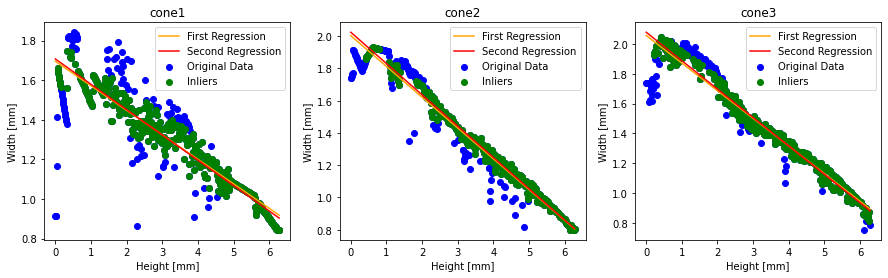

In [190]:
first_reg, second_reg = width_interpolation_with_second_regression(df_smoothed*0.006, number_of_slices*0.003)

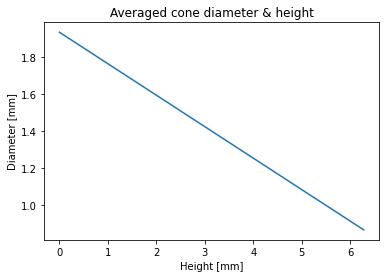

In [ ]:
# Compute and plot the average of the second regression curves across all cones.
# 1. `y_fit_full_list` contains the second regression (inlier-based) curves for each cone.
# 2. Convert to a NumPy array and take the element-wise mean to get a single averaged curve.
# 3. Use the same x-values that were used for the regression curves (scaled if needed).
# 4. Plot the averaged curve to visualize the overall trend of cone diameter versus height.

y_fit_full_list = second_reg  # each array has the same length, e.g., 100

# Convert to a NumPy array and compute the element-wise mean over the three curves (axis=0)
avg_y_fit = np.mean(np.array(y_fit_full_list), axis=0)

# Ideally, use the same x values that were used to generate the regression curves.
# If x was defined as:
x = np.linspace(np.min(number_of_slices), np.max(number_of_slices), len(avg_y_fit))

# Now plot the averaged regression.
plt.plot(x * 0.003, avg_y_fit)  # scale x if necessary
plt.title("Averaged cone diameter & height")
plt.xlabel("Height [mm]")
plt.ylabel("Diameter [mm]")
plt.show()


In [ ]:
# Save processed data for later use or analysis:
# 1. `all_hvd`: all second-regression curves for each cone (NumPy array).
# 2. `avg_hvd`: averaged regression curve across all cones (NumPy array).
# 3. `im_list`: list of processed images (NumPy array).
# 4. `df_ellips_cleaned`: cleaned ellipse measurements saved as a CSV file.


#np.save('all_hvd',np.array(y_fit_full_list))
#np.save('avg_hvd',np.array(avg_y_fit))
#np.save('im_list',np.array(im_list))
#df_ellips_cleaned.to_csv('output.csv', index=False)